# Image Matching

In [1]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image, ImageOps
from scipy.spatial import cKDTree
from skimage.feature import plot_matches
from skimage.measure import ransac
from skimage.transform import AffineTransform
from six import BytesIO
import tensorflow as tf
import tensorflow_hub as hub
from six.moves.urllib.request import urlopen
import cv2
import imutils
import glob
import os
from itertools import accumulate
import sys
sys.path.append('/home/tung/playground/delf_instance_retrieval/delf/delf/python/examples/')
from utils import download_and_resize_image, resize_image, show_images, image_input_fn, match_images

np.random.seed(10)

In [ ]:
#!pip install scikit-image
#!pip install tensorflow-hub
#!pip install opencv-python
#!pip install imutils

## Match an image pair

In [3]:
#IMAGE_1_URL = 'https://images.unsplash.com/photo-1522184808165-a39a75502037?ixlib=rb-0.3.5&ixid=eyJhcHBfaWQiOjEyMDd9&s=9058a9f269234b4d7b6dc7bd7066d7e8&auto=format&fit=crop&w=1350&q=80'
#IMAGE_2_URL = 'https://images.unsplash.com/photo-1479660656269-197ebb83b540?ixlib=rb-0.3.5&ixid=eyJhcHBfaWQiOjEyMDd9&s=88b85498e4c076fce0ed0c086543afb6&auto=format&fit=crop&w=1952&q=80'

IMAGE_1_JPG = '1_1.jpg'
IMAGE_2_JPG = '1_2.jpg'

IMAGE_1_URL = '../images/' + IMAGE_1_JPG
IMAGE_2_URL = '../images/' + IMAGE_2_JPG

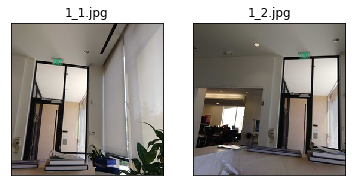

In [5]:
resize_image(IMAGE_1_URL, IMAGE_1_JPG)
resize_image(IMAGE_2_URL, IMAGE_2_JPG)
#download_and_resize_image(IMAGE_1_URL, IMAGE_1_JPG)
#download_and_resize_image(IMAGE_2_URL, IMAGE_2_JPG)

show_images([IMAGE_1_JPG, IMAGE_2_JPG])

In [6]:
# load delf model


tf.reset_default_graph()
tf.logging.set_verbosity(tf.logging.FATAL)

# load model
m = hub.Module('https://tfhub.dev/google/delf/1')

# The module operates on a single image at a time, so define a placeholder to
# feed an arbitrary image in.
image_placeholder = tf.placeholder(
    tf.float32, shape=(None, None, 3), name='input_image')

module_inputs = {
    'image': image_placeholder, # Image tensor with dtype float32 and shape [height, width, 3]
    'score_threshold': 100.0, # Image features whose attention score exceeds this threshold will be returned
    'image_scales': [0.25, 0.3536, 0.5, 0.7071, 1.0, 1.4142, 2.0],
    'max_feature_num': 1000, # The maximum number of features that should be returned
}

# Apply the DELF module to the inputs to get the outputs.
module_outputs = m(module_inputs, as_dict=True)

In [7]:
image_tf = image_input_fn([IMAGE_1_JPG, IMAGE_2_JPG])

with tf.train.MonitoredSession() as sess:
    results_dict = {}  # Stores the locations and their descriptors for each image
    for image_path in [IMAGE_1_JPG, IMAGE_2_JPG]:
        image = sess.run(image_tf)
        print('Extracting locations and descriptors from %s' % image_path)
        results_dict[image_path] = sess.run(
            [module_outputs['locations'], module_outputs['descriptors']],
            feed_dict={image_placeholder: image})

# delf_outputs is a dictionary of named tensors:
# * delf_outputs['locations']: a Tensor with dtype float32 and shape [None, 2],
#   where each entry is a coordinate (vertical-offset, horizontal-offset) in
#   pixels from the top-left corner of the image.
# * delf_outputs['descriptors']: a Tensor with dtype float32 and shape
#   [None, 40], where delf_outputs['descriptors'][i] is a 40-dimensional
#   descriptor for the image at location delf_outputs['locations'][i].

Extracting locations and descriptors from 1_1.jpg
Extracting locations and descriptors from 1_2.jpg


Loaded image 1's 79 features
Loaded image 2's 80 features


/usr/local/lib/python3.6/dist-packages/skimage/transform/_geometric.py:683: RuntimeWarning: divide by zero encountered in true_divide
  H.flat[list(self._coeffs) + [8]] = - V[-1, :-1] / V[-1, -1]
/usr/local/lib/python3.6/dist-packages/skimage/transform/_geometric.py:683: RuntimeWarning: invalid value encountered in true_divide
  H.flat[list(self._coeffs) + [8]] = - V[-1, :-1] / V[-1, -1]
/usr/local/lib/python3.6/dist-packages/skimage/measure/fit.py:831: RuntimeWarning: invalid value encountered in less
  sample_model_inliers = sample_model_residuals < residual_threshold


Found 23 inliers


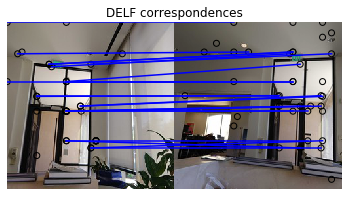

In [8]:
match_images(results_dict, IMAGE_1_JPG, IMAGE_2_JPG)

## Match a query to the database

In [ ]:
import csv
import codecs
building_descs = []
f = codecs.open('./images/buildings.csv', 'rU', encoding='utf-8-sig')
reader = csv.reader(f)
for utf8_row in reader:
    building_descs.append(utf8_row[0])
building_descs

### Resize all database images

In [17]:
def resize_image(srcfile, destfile, new_width=256, new_height=256):
    pil_image = Image.open(srcfile)
    pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS)
    pil_image_rgb = pil_image.convert('RGB')
    pil_image_rgb.save(destfile, format='JPEG', quality=90)
    return destfile
def resize_images_folder(srcfolder, destfolder='../images/resized', new_width=256, new_height=256):
    os.makedirs(destfolder,exist_ok=True)
    for srcfile in glob.iglob(os.path.join('../images/oxford5k_images', '*.[Jj][Pp][Gg]')):
        src_basename = os.path.basename(srcfile)
        destfile=os.path.join(destfolder,src_basename)
        resize_image(srcfile, destfile, new_width, new_height)
    return destfolder
def get_resized_db_image_paths(destfolder='../images/resized'):
    return sorted(list(glob.iglob(os.path.join(destfolder, '*.[Jj][Pp][Gg]'))))

In [15]:
#resize_images_folder('../images/oxford5k_images')

In [19]:
db_images = get_resized_db_image_paths()
db_images

['../images/resized/all_souls_000000.jpg',
 '../images/resized/all_souls_000001.jpg',
 '../images/resized/all_souls_000002.jpg',
 '../images/resized/all_souls_000003.jpg',
 '../images/resized/all_souls_000005.jpg',
 '../images/resized/all_souls_000006.jpg',
 '../images/resized/all_souls_000007.jpg',
 '../images/resized/all_souls_000008.jpg',
 '../images/resized/all_souls_000010.jpg',
 '../images/resized/all_souls_000011.jpg',
 '../images/resized/all_souls_000012.jpg',
 '../images/resized/all_souls_000013.jpg',
 '../images/resized/all_souls_000014.jpg',
 '../images/resized/all_souls_000015.jpg',
 '../images/resized/all_souls_000016.jpg',
 '../images/resized/all_souls_000017.jpg',
 '../images/resized/all_souls_000018.jpg',
 '../images/resized/all_souls_000019.jpg',
 '../images/resized/all_souls_000020.jpg',
 '../images/resized/all_souls_000021.jpg',
 '../images/resized/all_souls_000022.jpg',
 '../images/resized/all_souls_000026.jpg',
 '../images/resized/all_souls_000027.jpg',
 '../images

In [20]:
tf.reset_default_graph()
tf.logging.set_verbosity(tf.logging.FATAL)

m = hub.Module('https://tfhub.dev/google/delf/1')

# The module operates on a single image at a time, so define a placeholder to
# feed an arbitrary image in.
image_placeholder = tf.placeholder(
    tf.float32, shape=(None, None, 3), name='input_image')

module_inputs = {
    'image': image_placeholder,
    'score_threshold': 100.0,
    'image_scales': [0.25, 0.3536, 0.5, 0.7071, 1.0, 1.4142, 2.0],
    'max_feature_num': 1000,
}

module_outputs = m(module_inputs, as_dict=True)

image_tf = image_input_fn(db_images)

with tf.train.MonitoredSession() as sess:
    results_dict = {}  # Stores the locations and their descriptors for each image
    for image_path in db_images:
        image = sess.run(image_tf)
        print('Extracting locations and descriptors from %s' % image_path)
        results_dict[image_path] = sess.run(
            [module_outputs['locations'], module_outputs['descriptors']],
            feed_dict={image_placeholder: image})

Extracting locations and descriptors from ../images/resized/all_souls_000000.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000001.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000002.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000003.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000005.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000006.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000007.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000008.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000010.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000011.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000012.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000013.jpg
Extracting locations and des

Extracting locations and descriptors from ../images/resized/all_souls_000175.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000176.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000180.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000181.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000182.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000183.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000184.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000186.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000188.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000190.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000191.jpg
Extracting locations and descriptors from ../images/resized/all_souls_000192.jpg
Extracting locations and des

Extracting locations and descriptors from ../images/resized/ashmolean_000174.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000175.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000176.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000177.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000178.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000179.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000180.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000183.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000184.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000185.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000186.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000187.jpg
Extracting locations and des

Extracting locations and descriptors from ../images/resized/ashmolean_000306.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000307.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000309.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000310.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000314.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000316.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000322.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000324.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000326.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000331.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000334.jpg
Extracting locations and descriptors from ../images/resized/ashmolean_000336.jpg
Extracting locations and des

Extracting locations and descriptors from ../images/resized/balliol_000115.jpg
Extracting locations and descriptors from ../images/resized/balliol_000116.jpg
Extracting locations and descriptors from ../images/resized/balliol_000117.jpg
Extracting locations and descriptors from ../images/resized/balliol_000118.jpg
Extracting locations and descriptors from ../images/resized/balliol_000119.jpg
Extracting locations and descriptors from ../images/resized/balliol_000120.jpg
Extracting locations and descriptors from ../images/resized/balliol_000121.jpg
Extracting locations and descriptors from ../images/resized/balliol_000122.jpg
Extracting locations and descriptors from ../images/resized/balliol_000123.jpg
Extracting locations and descriptors from ../images/resized/balliol_000124.jpg
Extracting locations and descriptors from ../images/resized/balliol_000134.jpg
Extracting locations and descriptors from ../images/resized/balliol_000135.jpg
Extracting locations and descriptors from ../images/

Extracting locations and descriptors from ../images/resized/bodleian_000084.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000085.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000088.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000090.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000094.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000095.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000096.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000101.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000102.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000104.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000105.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000106.jpg
Extracting locations and descriptors fro

Extracting locations and descriptors from ../images/resized/bodleian_000351.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000354.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000355.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000356.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000357.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000359.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000360.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000361.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000363.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000364.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000365.jpg
Extracting locations and descriptors from ../images/resized/bodleian_000366.jpg
Extracting locations and descriptors fro

Extracting locations and descriptors from ../images/resized/christ_church_000070.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000071.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000072.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000073.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000074.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000076.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000077.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000078.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000079.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000081.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000085.jpg
Extracting locations and descriptors from ../images/resized/chris

Extracting locations and descriptors from ../images/resized/christ_church_000224.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000226.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000227.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000228.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000239.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000258.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000259.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000260.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000261.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000262.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000263.jpg
Extracting locations and descriptors from ../images/resized/chris

Extracting locations and descriptors from ../images/resized/christ_church_000392.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000393.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000395.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000396.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000398.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000400.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000402.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000403.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000404.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000406.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000407.jpg
Extracting locations and descriptors from ../images/resized/chris

Extracting locations and descriptors from ../images/resized/christ_church_000655.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000658.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000661.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000664.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000667.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000672.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000673.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000675.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000679.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000681.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000682.jpg
Extracting locations and descriptors from ../images/resized/chris

Extracting locations and descriptors from ../images/resized/christ_church_000896.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000897.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000898.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000900.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000901.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000903.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000904.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000906.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000907.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000911.jpg
Extracting locations and descriptors from ../images/resized/christ_church_000912.jpg
Extracting locations and descriptors from ../images/resized/chris

Extracting locations and descriptors from ../images/resized/christ_church_001068.jpg
Extracting locations and descriptors from ../images/resized/christ_church_001069.jpg
Extracting locations and descriptors from ../images/resized/christ_church_001070.jpg
Extracting locations and descriptors from ../images/resized/christ_church_001071.jpg
Extracting locations and descriptors from ../images/resized/christ_church_001078.jpg
Extracting locations and descriptors from ../images/resized/christ_church_001083.jpg
Extracting locations and descriptors from ../images/resized/christ_church_001088.jpg
Extracting locations and descriptors from ../images/resized/christ_church_001094.jpg
Extracting locations and descriptors from ../images/resized/christ_church_001100.jpg
Extracting locations and descriptors from ../images/resized/christ_church_001104.jpg
Extracting locations and descriptors from ../images/resized/christ_church_001113.jpg
Extracting locations and descriptors from ../images/resized/chris

Extracting locations and descriptors from ../images/resized/hertford_000056.jpg
Extracting locations and descriptors from ../images/resized/hertford_000057.jpg
Extracting locations and descriptors from ../images/resized/hertford_000059.jpg
Extracting locations and descriptors from ../images/resized/hertford_000060.jpg
Extracting locations and descriptors from ../images/resized/hertford_000062.jpg
Extracting locations and descriptors from ../images/resized/hertford_000063.jpg
Extracting locations and descriptors from ../images/resized/hertford_000064.jpg
Extracting locations and descriptors from ../images/resized/hertford_000066.jpg
Extracting locations and descriptors from ../images/resized/hertford_000068.jpg
Extracting locations and descriptors from ../images/resized/hertford_000070.jpg
Extracting locations and descriptors from ../images/resized/hertford_000071.jpg
Extracting locations and descriptors from ../images/resized/hertford_000073.jpg
Extracting locations and descriptors fro

Extracting locations and descriptors from ../images/resized/jesus_000249.jpg
Extracting locations and descriptors from ../images/resized/jesus_000260.jpg
Extracting locations and descriptors from ../images/resized/jesus_000261.jpg
Extracting locations and descriptors from ../images/resized/jesus_000265.jpg
Extracting locations and descriptors from ../images/resized/jesus_000272.jpg
Extracting locations and descriptors from ../images/resized/jesus_000275.jpg
Extracting locations and descriptors from ../images/resized/jesus_000276.jpg
Extracting locations and descriptors from ../images/resized/jesus_000277.jpg
Extracting locations and descriptors from ../images/resized/jesus_000278.jpg
Extracting locations and descriptors from ../images/resized/jesus_000279.jpg
Extracting locations and descriptors from ../images/resized/jesus_000280.jpg
Extracting locations and descriptors from ../images/resized/jesus_000281.jpg
Extracting locations and descriptors from ../images/resized/jesus_000282.jpg

Extracting locations and descriptors from ../images/resized/keble_000018.jpg
Extracting locations and descriptors from ../images/resized/keble_000019.jpg
Extracting locations and descriptors from ../images/resized/keble_000021.jpg
Extracting locations and descriptors from ../images/resized/keble_000022.jpg
Extracting locations and descriptors from ../images/resized/keble_000023.jpg
Extracting locations and descriptors from ../images/resized/keble_000025.jpg
Extracting locations and descriptors from ../images/resized/keble_000026.jpg
Extracting locations and descriptors from ../images/resized/keble_000027.jpg
Extracting locations and descriptors from ../images/resized/keble_000028.jpg
Extracting locations and descriptors from ../images/resized/keble_000030.jpg
Extracting locations and descriptors from ../images/resized/keble_000031.jpg
Extracting locations and descriptors from ../images/resized/keble_000032.jpg
Extracting locations and descriptors from ../images/resized/keble_000033.jpg

Extracting locations and descriptors from ../images/resized/keble_000251.jpg
Extracting locations and descriptors from ../images/resized/keble_000253.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000000.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000001.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000002.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000004.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000005.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000006.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000007.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000008.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000009.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000011.jpg
Extracting locations and descriptors from ../i

Extracting locations and descriptors from ../images/resized/magdalen_000159.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000160.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000161.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000162.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000163.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000164.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000165.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000167.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000169.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000171.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000172.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000173.jpg
Extracting locations and descriptors fro

Extracting locations and descriptors from ../images/resized/magdalen_000284.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000285.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000286.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000287.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000288.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000289.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000290.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000291.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000293.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000294.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000295.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000296.jpg
Extracting locations and descriptors fro

Extracting locations and descriptors from ../images/resized/magdalen_000495.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000496.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000503.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000504.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000505.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000506.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000507.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000508.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000509.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000510.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000511.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000512.jpg
Extracting locations and descriptors fro

Extracting locations and descriptors from ../images/resized/magdalen_000657.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000658.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000660.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000661.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000662.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000663.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000664.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000665.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000667.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000669.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000670.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000671.jpg
Extracting locations and descriptors fro

Extracting locations and descriptors from ../images/resized/magdalen_000832.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000837.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000838.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000843.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000844.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000847.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000849.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000850.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000851.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000852.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000855.jpg
Extracting locations and descriptors from ../images/resized/magdalen_000856.jpg
Extracting locations and descriptors fro

Extracting locations and descriptors from ../images/resized/magdalen_001044.jpg
Extracting locations and descriptors from ../images/resized/magdalen_001045.jpg
Extracting locations and descriptors from ../images/resized/magdalen_001048.jpg
Extracting locations and descriptors from ../images/resized/magdalen_001049.jpg
Extracting locations and descriptors from ../images/resized/magdalen_001051.jpg
Extracting locations and descriptors from ../images/resized/magdalen_001055.jpg
Extracting locations and descriptors from ../images/resized/magdalen_001056.jpg
Extracting locations and descriptors from ../images/resized/magdalen_001057.jpg
Extracting locations and descriptors from ../images/resized/magdalen_001058.jpg
Extracting locations and descriptors from ../images/resized/magdalen_001059.jpg
Extracting locations and descriptors from ../images/resized/magdalen_001060.jpg
Extracting locations and descriptors from ../images/resized/magdalen_001063.jpg
Extracting locations and descriptors fro

Extracting locations and descriptors from ../images/resized/new_000128.jpg
Extracting locations and descriptors from ../images/resized/new_000134.jpg
Extracting locations and descriptors from ../images/resized/new_000136.jpg
Extracting locations and descriptors from ../images/resized/new_000137.jpg
Extracting locations and descriptors from ../images/resized/new_000143.jpg
Extracting locations and descriptors from ../images/resized/new_000145.jpg
Extracting locations and descriptors from ../images/resized/new_000150.jpg
Extracting locations and descriptors from ../images/resized/new_000154.jpg
Extracting locations and descriptors from ../images/resized/new_000156.jpg
Extracting locations and descriptors from ../images/resized/new_000161.jpg
Extracting locations and descriptors from ../images/resized/new_000164.jpg
Extracting locations and descriptors from ../images/resized/new_000168.jpg
Extracting locations and descriptors from ../images/resized/new_000170.jpg
Extracting locations and 

Extracting locations and descriptors from ../images/resized/new_000393.jpg
Extracting locations and descriptors from ../images/resized/new_000397.jpg
Extracting locations and descriptors from ../images/resized/new_000399.jpg
Extracting locations and descriptors from ../images/resized/new_000402.jpg
Extracting locations and descriptors from ../images/resized/new_000404.jpg
Extracting locations and descriptors from ../images/resized/new_000405.jpg
Extracting locations and descriptors from ../images/resized/new_000406.jpg
Extracting locations and descriptors from ../images/resized/new_000407.jpg
Extracting locations and descriptors from ../images/resized/new_000408.jpg
Extracting locations and descriptors from ../images/resized/new_000409.jpg
Extracting locations and descriptors from ../images/resized/new_000410.jpg
Extracting locations and descriptors from ../images/resized/new_000417.jpg
Extracting locations and descriptors from ../images/resized/new_000418.jpg
Extracting locations and 

Extracting locations and descriptors from ../images/resized/new_000691.jpg
Extracting locations and descriptors from ../images/resized/new_000692.jpg
Extracting locations and descriptors from ../images/resized/new_000693.jpg
Extracting locations and descriptors from ../images/resized/new_000699.jpg
Extracting locations and descriptors from ../images/resized/new_000703.jpg
Extracting locations and descriptors from ../images/resized/new_000705.jpg
Extracting locations and descriptors from ../images/resized/new_000706.jpg
Extracting locations and descriptors from ../images/resized/new_000707.jpg
Extracting locations and descriptors from ../images/resized/new_000721.jpg
Extracting locations and descriptors from ../images/resized/new_000722.jpg
Extracting locations and descriptors from ../images/resized/new_000723.jpg
Extracting locations and descriptors from ../images/resized/new_000724.jpg
Extracting locations and descriptors from ../images/resized/new_000725.jpg
Extracting locations and 

Extracting locations and descriptors from ../images/resized/new_000939.jpg
Extracting locations and descriptors from ../images/resized/new_000940.jpg
Extracting locations and descriptors from ../images/resized/new_000948.jpg
Extracting locations and descriptors from ../images/resized/new_000949.jpg
Extracting locations and descriptors from ../images/resized/new_000950.jpg
Extracting locations and descriptors from ../images/resized/new_000951.jpg
Extracting locations and descriptors from ../images/resized/new_000952.jpg
Extracting locations and descriptors from ../images/resized/new_000956.jpg
Extracting locations and descriptors from ../images/resized/new_000960.jpg
Extracting locations and descriptors from ../images/resized/new_000961.jpg
Extracting locations and descriptors from ../images/resized/new_000962.jpg
Extracting locations and descriptors from ../images/resized/new_000963.jpg
Extracting locations and descriptors from ../images/resized/new_000964.jpg
Extracting locations and 

Extracting locations and descriptors from ../images/resized/oriel_000036.jpg
Extracting locations and descriptors from ../images/resized/oriel_000037.jpg
Extracting locations and descriptors from ../images/resized/oriel_000038.jpg
Extracting locations and descriptors from ../images/resized/oriel_000039.jpg
Extracting locations and descriptors from ../images/resized/oriel_000040.jpg
Extracting locations and descriptors from ../images/resized/oriel_000041.jpg
Extracting locations and descriptors from ../images/resized/oriel_000042.jpg
Extracting locations and descriptors from ../images/resized/oriel_000043.jpg
Extracting locations and descriptors from ../images/resized/oriel_000044.jpg
Extracting locations and descriptors from ../images/resized/oriel_000045.jpg
Extracting locations and descriptors from ../images/resized/oriel_000046.jpg
Extracting locations and descriptors from ../images/resized/oriel_000047.jpg
Extracting locations and descriptors from ../images/resized/oriel_000048.jpg

Extracting locations and descriptors from ../images/resized/oxford_000076.jpg
Extracting locations and descriptors from ../images/resized/oxford_000078.jpg
Extracting locations and descriptors from ../images/resized/oxford_000079.jpg
Extracting locations and descriptors from ../images/resized/oxford_000080.jpg
Extracting locations and descriptors from ../images/resized/oxford_000081.jpg
Extracting locations and descriptors from ../images/resized/oxford_000082.jpg
Extracting locations and descriptors from ../images/resized/oxford_000087.jpg
Extracting locations and descriptors from ../images/resized/oxford_000090.jpg
Extracting locations and descriptors from ../images/resized/oxford_000091.jpg
Extracting locations and descriptors from ../images/resized/oxford_000095.jpg
Extracting locations and descriptors from ../images/resized/oxford_000098.jpg
Extracting locations and descriptors from ../images/resized/oxford_000099.jpg
Extracting locations and descriptors from ../images/resized/oxfo

Extracting locations and descriptors from ../images/resized/oxford_000359.jpg
Extracting locations and descriptors from ../images/resized/oxford_000371.jpg
Extracting locations and descriptors from ../images/resized/oxford_000374.jpg
Extracting locations and descriptors from ../images/resized/oxford_000375.jpg
Extracting locations and descriptors from ../images/resized/oxford_000377.jpg
Extracting locations and descriptors from ../images/resized/oxford_000378.jpg
Extracting locations and descriptors from ../images/resized/oxford_000379.jpg
Extracting locations and descriptors from ../images/resized/oxford_000380.jpg
Extracting locations and descriptors from ../images/resized/oxford_000383.jpg
Extracting locations and descriptors from ../images/resized/oxford_000384.jpg
Extracting locations and descriptors from ../images/resized/oxford_000385.jpg
Extracting locations and descriptors from ../images/resized/oxford_000386.jpg
Extracting locations and descriptors from ../images/resized/oxfo

Extracting locations and descriptors from ../images/resized/oxford_000627.jpg
Extracting locations and descriptors from ../images/resized/oxford_000633.jpg
Extracting locations and descriptors from ../images/resized/oxford_000635.jpg
Extracting locations and descriptors from ../images/resized/oxford_000636.jpg
Extracting locations and descriptors from ../images/resized/oxford_000637.jpg
Extracting locations and descriptors from ../images/resized/oxford_000638.jpg
Extracting locations and descriptors from ../images/resized/oxford_000646.jpg
Extracting locations and descriptors from ../images/resized/oxford_000655.jpg
Extracting locations and descriptors from ../images/resized/oxford_000656.jpg
Extracting locations and descriptors from ../images/resized/oxford_000657.jpg
Extracting locations and descriptors from ../images/resized/oxford_000658.jpg
Extracting locations and descriptors from ../images/resized/oxford_000659.jpg
Extracting locations and descriptors from ../images/resized/oxfo

Extracting locations and descriptors from ../images/resized/oxford_000884.jpg
Extracting locations and descriptors from ../images/resized/oxford_000890.jpg
Extracting locations and descriptors from ../images/resized/oxford_000896.jpg
Extracting locations and descriptors from ../images/resized/oxford_000897.jpg
Extracting locations and descriptors from ../images/resized/oxford_000898.jpg
Extracting locations and descriptors from ../images/resized/oxford_000900.jpg
Extracting locations and descriptors from ../images/resized/oxford_000901.jpg
Extracting locations and descriptors from ../images/resized/oxford_000902.jpg
Extracting locations and descriptors from ../images/resized/oxford_000903.jpg
Extracting locations and descriptors from ../images/resized/oxford_000904.jpg
Extracting locations and descriptors from ../images/resized/oxford_000905.jpg
Extracting locations and descriptors from ../images/resized/oxford_000906.jpg
Extracting locations and descriptors from ../images/resized/oxfo

Extracting locations and descriptors from ../images/resized/oxford_001125.jpg
Extracting locations and descriptors from ../images/resized/oxford_001127.jpg
Extracting locations and descriptors from ../images/resized/oxford_001131.jpg
Extracting locations and descriptors from ../images/resized/oxford_001134.jpg
Extracting locations and descriptors from ../images/resized/oxford_001139.jpg
Extracting locations and descriptors from ../images/resized/oxford_001144.jpg
Extracting locations and descriptors from ../images/resized/oxford_001145.jpg
Extracting locations and descriptors from ../images/resized/oxford_001147.jpg
Extracting locations and descriptors from ../images/resized/oxford_001150.jpg
Extracting locations and descriptors from ../images/resized/oxford_001152.jpg
Extracting locations and descriptors from ../images/resized/oxford_001154.jpg
Extracting locations and descriptors from ../images/resized/oxford_001159.jpg
Extracting locations and descriptors from ../images/resized/oxfo

Extracting locations and descriptors from ../images/resized/oxford_001396.jpg
Extracting locations and descriptors from ../images/resized/oxford_001397.jpg
Extracting locations and descriptors from ../images/resized/oxford_001402.jpg
Extracting locations and descriptors from ../images/resized/oxford_001404.jpg
Extracting locations and descriptors from ../images/resized/oxford_001405.jpg
Extracting locations and descriptors from ../images/resized/oxford_001406.jpg
Extracting locations and descriptors from ../images/resized/oxford_001407.jpg
Extracting locations and descriptors from ../images/resized/oxford_001410.jpg
Extracting locations and descriptors from ../images/resized/oxford_001411.jpg
Extracting locations and descriptors from ../images/resized/oxford_001413.jpg
Extracting locations and descriptors from ../images/resized/oxford_001427.jpg
Extracting locations and descriptors from ../images/resized/oxford_001431.jpg
Extracting locations and descriptors from ../images/resized/oxfo

Extracting locations and descriptors from ../images/resized/oxford_001676.jpg
Extracting locations and descriptors from ../images/resized/oxford_001679.jpg
Extracting locations and descriptors from ../images/resized/oxford_001692.jpg
Extracting locations and descriptors from ../images/resized/oxford_001693.jpg
Extracting locations and descriptors from ../images/resized/oxford_001696.jpg
Extracting locations and descriptors from ../images/resized/oxford_001697.jpg
Extracting locations and descriptors from ../images/resized/oxford_001699.jpg
Extracting locations and descriptors from ../images/resized/oxford_001700.jpg
Extracting locations and descriptors from ../images/resized/oxford_001704.jpg
Extracting locations and descriptors from ../images/resized/oxford_001706.jpg
Extracting locations and descriptors from ../images/resized/oxford_001707.jpg
Extracting locations and descriptors from ../images/resized/oxford_001708.jpg
Extracting locations and descriptors from ../images/resized/oxfo

Extracting locations and descriptors from ../images/resized/oxford_001937.jpg
Extracting locations and descriptors from ../images/resized/oxford_001940.jpg
Extracting locations and descriptors from ../images/resized/oxford_001946.jpg
Extracting locations and descriptors from ../images/resized/oxford_001949.jpg
Extracting locations and descriptors from ../images/resized/oxford_001950.jpg
Extracting locations and descriptors from ../images/resized/oxford_001951.jpg
Extracting locations and descriptors from ../images/resized/oxford_001953.jpg
Extracting locations and descriptors from ../images/resized/oxford_001955.jpg
Extracting locations and descriptors from ../images/resized/oxford_001956.jpg
Extracting locations and descriptors from ../images/resized/oxford_001960.jpg
Extracting locations and descriptors from ../images/resized/oxford_001961.jpg
Extracting locations and descriptors from ../images/resized/oxford_001962.jpg
Extracting locations and descriptors from ../images/resized/oxfo

Extracting locations and descriptors from ../images/resized/oxford_002197.jpg
Extracting locations and descriptors from ../images/resized/oxford_002198.jpg
Extracting locations and descriptors from ../images/resized/oxford_002200.jpg
Extracting locations and descriptors from ../images/resized/oxford_002202.jpg
Extracting locations and descriptors from ../images/resized/oxford_002203.jpg
Extracting locations and descriptors from ../images/resized/oxford_002205.jpg
Extracting locations and descriptors from ../images/resized/oxford_002207.jpg
Extracting locations and descriptors from ../images/resized/oxford_002208.jpg
Extracting locations and descriptors from ../images/resized/oxford_002217.jpg
Extracting locations and descriptors from ../images/resized/oxford_002236.jpg
Extracting locations and descriptors from ../images/resized/oxford_002237.jpg
Extracting locations and descriptors from ../images/resized/oxford_002238.jpg
Extracting locations and descriptors from ../images/resized/oxfo

Extracting locations and descriptors from ../images/resized/oxford_002461.jpg
Extracting locations and descriptors from ../images/resized/oxford_002462.jpg
Extracting locations and descriptors from ../images/resized/oxford_002464.jpg
Extracting locations and descriptors from ../images/resized/oxford_002469.jpg
Extracting locations and descriptors from ../images/resized/oxford_002470.jpg
Extracting locations and descriptors from ../images/resized/oxford_002471.jpg
Extracting locations and descriptors from ../images/resized/oxford_002472.jpg
Extracting locations and descriptors from ../images/resized/oxford_002473.jpg
Extracting locations and descriptors from ../images/resized/oxford_002476.jpg
Extracting locations and descriptors from ../images/resized/oxford_002482.jpg
Extracting locations and descriptors from ../images/resized/oxford_002494.jpg
Extracting locations and descriptors from ../images/resized/oxford_002496.jpg
Extracting locations and descriptors from ../images/resized/oxfo

Extracting locations and descriptors from ../images/resized/oxford_002713.jpg
Extracting locations and descriptors from ../images/resized/oxford_002714.jpg
Extracting locations and descriptors from ../images/resized/oxford_002715.jpg
Extracting locations and descriptors from ../images/resized/oxford_002719.jpg
Extracting locations and descriptors from ../images/resized/oxford_002723.jpg
Extracting locations and descriptors from ../images/resized/oxford_002724.jpg
Extracting locations and descriptors from ../images/resized/oxford_002725.jpg
Extracting locations and descriptors from ../images/resized/oxford_002726.jpg
Extracting locations and descriptors from ../images/resized/oxford_002728.jpg
Extracting locations and descriptors from ../images/resized/oxford_002729.jpg
Extracting locations and descriptors from ../images/resized/oxford_002730.jpg
Extracting locations and descriptors from ../images/resized/oxford_002733.jpg
Extracting locations and descriptors from ../images/resized/oxfo

Extracting locations and descriptors from ../images/resized/oxford_002991.jpg
Extracting locations and descriptors from ../images/resized/oxford_002992.jpg
Extracting locations and descriptors from ../images/resized/oxford_003002.jpg
Extracting locations and descriptors from ../images/resized/oxford_003006.jpg
Extracting locations and descriptors from ../images/resized/oxford_003007.jpg
Extracting locations and descriptors from ../images/resized/oxford_003008.jpg
Extracting locations and descriptors from ../images/resized/oxford_003009.jpg
Extracting locations and descriptors from ../images/resized/oxford_003010.jpg
Extracting locations and descriptors from ../images/resized/oxford_003011.jpg
Extracting locations and descriptors from ../images/resized/oxford_003012.jpg
Extracting locations and descriptors from ../images/resized/oxford_003014.jpg
Extracting locations and descriptors from ../images/resized/oxford_003015.jpg
Extracting locations and descriptors from ../images/resized/oxfo

Extracting locations and descriptors from ../images/resized/oxford_003193.jpg
Extracting locations and descriptors from ../images/resized/oxford_003194.jpg
Extracting locations and descriptors from ../images/resized/oxford_003202.jpg
Extracting locations and descriptors from ../images/resized/oxford_003204.jpg
Extracting locations and descriptors from ../images/resized/oxford_003205.jpg
Extracting locations and descriptors from ../images/resized/oxford_003225.jpg
Extracting locations and descriptors from ../images/resized/oxford_003226.jpg
Extracting locations and descriptors from ../images/resized/oxford_003228.jpg
Extracting locations and descriptors from ../images/resized/oxford_003230.jpg
Extracting locations and descriptors from ../images/resized/oxford_003235.jpg
Extracting locations and descriptors from ../images/resized/oxford_003248.jpg
Extracting locations and descriptors from ../images/resized/oxford_003249.jpg
Extracting locations and descriptors from ../images/resized/oxfo

Extracting locations and descriptors from ../images/resized/oxford_003467.jpg
Extracting locations and descriptors from ../images/resized/oxford_003468.jpg
Extracting locations and descriptors from ../images/resized/oxford_003474.jpg
Extracting locations and descriptors from ../images/resized/oxford_003477.jpg
Extracting locations and descriptors from ../images/resized/oxford_003478.jpg
Extracting locations and descriptors from ../images/resized/oxford_003480.jpg
Extracting locations and descriptors from ../images/resized/oxford_003482.jpg
Extracting locations and descriptors from ../images/resized/oxford_003492.jpg
Extracting locations and descriptors from ../images/resized/oxford_003494.jpg
Extracting locations and descriptors from ../images/resized/oxford_003496.jpg
Extracting locations and descriptors from ../images/resized/oxford_003498.jpg
Extracting locations and descriptors from ../images/resized/oxford_003500.jpg
Extracting locations and descriptors from ../images/resized/oxfo

Extracting locations and descriptors from ../images/resized/pitt_rivers_000044.jpg
Extracting locations and descriptors from ../images/resized/pitt_rivers_000045.jpg
Extracting locations and descriptors from ../images/resized/pitt_rivers_000046.jpg
Extracting locations and descriptors from ../images/resized/pitt_rivers_000055.jpg
Extracting locations and descriptors from ../images/resized/pitt_rivers_000056.jpg
Extracting locations and descriptors from ../images/resized/pitt_rivers_000057.jpg
Extracting locations and descriptors from ../images/resized/pitt_rivers_000058.jpg
Extracting locations and descriptors from ../images/resized/pitt_rivers_000059.jpg
Extracting locations and descriptors from ../images/resized/pitt_rivers_000060.jpg
Extracting locations and descriptors from ../images/resized/pitt_rivers_000062.jpg
Extracting locations and descriptors from ../images/resized/pitt_rivers_000063.jpg
Extracting locations and descriptors from ../images/resized/pitt_rivers_000064.jpg
Extr

Extracting locations and descriptors from ../images/resized/radcliffe_camera_000042.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000043.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000047.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000050.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000052.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000053.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000057.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000059.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000063.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000064.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000065.jpg
Extracting locations and descrip

Extracting locations and descriptors from ../images/resized/radcliffe_camera_000230.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000231.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000232.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000233.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000234.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000235.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000238.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000239.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000240.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000241.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000246.jpg
Extracting locations and descrip

Extracting locations and descriptors from ../images/resized/radcliffe_camera_000408.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000410.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000412.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000416.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000417.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000419.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000420.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000421.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000423.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000424.jpg
Extracting locations and descriptors from ../images/resized/radcliffe_camera_000425.jpg
Extracting locations and descrip

Extracting locations and descriptors from ../images/resized/trinity_000039.jpg
Extracting locations and descriptors from ../images/resized/trinity_000040.jpg
Extracting locations and descriptors from ../images/resized/trinity_000041.jpg
Extracting locations and descriptors from ../images/resized/trinity_000042.jpg
Extracting locations and descriptors from ../images/resized/trinity_000045.jpg
Extracting locations and descriptors from ../images/resized/trinity_000046.jpg
Extracting locations and descriptors from ../images/resized/trinity_000047.jpg
Extracting locations and descriptors from ../images/resized/trinity_000049.jpg
Extracting locations and descriptors from ../images/resized/trinity_000050.jpg
Extracting locations and descriptors from ../images/resized/trinity_000051.jpg
Extracting locations and descriptors from ../images/resized/trinity_000052.jpg
Extracting locations and descriptors from ../images/resized/trinity_000053.jpg
Extracting locations and descriptors from ../images/

Extracting locations and descriptors from ../images/resized/trinity_000210.jpg
Extracting locations and descriptors from ../images/resized/trinity_000211.jpg
Extracting locations and descriptors from ../images/resized/trinity_000212.jpg
Extracting locations and descriptors from ../images/resized/trinity_000213.jpg
Extracting locations and descriptors from ../images/resized/trinity_000223.jpg
Extracting locations and descriptors from ../images/resized/trinity_000224.jpg
Extracting locations and descriptors from ../images/resized/trinity_000225.jpg
Extracting locations and descriptors from ../images/resized/trinity_000226.jpg
Extracting locations and descriptors from ../images/resized/trinity_000227.jpg
Extracting locations and descriptors from ../images/resized/trinity_000233.jpg
Extracting locations and descriptors from ../images/resized/trinity_000234.jpg
Extracting locations and descriptors from ../images/resized/trinity_000235.jpg
Extracting locations and descriptors from ../images/

Extracting locations and descriptors from ../images/resized/worcester_000109.jpg
Extracting locations and descriptors from ../images/resized/worcester_000110.jpg
Extracting locations and descriptors from ../images/resized/worcester_000111.jpg
Extracting locations and descriptors from ../images/resized/worcester_000112.jpg
Extracting locations and descriptors from ../images/resized/worcester_000113.jpg
Extracting locations and descriptors from ../images/resized/worcester_000114.jpg
Extracting locations and descriptors from ../images/resized/worcester_000115.jpg
Extracting locations and descriptors from ../images/resized/worcester_000116.jpg
Extracting locations and descriptors from ../images/resized/worcester_000117.jpg
Extracting locations and descriptors from ../images/resized/worcester_000118.jpg
Extracting locations and descriptors from ../images/resized/worcester_000119.jpg
Extracting locations and descriptors from ../images/resized/worcester_000120.jpg
Extracting locations and des

In [21]:
def compute_locations_and_descriptors(image_path):
    tf.reset_default_graph()
    tf.logging.set_verbosity(tf.logging.FATAL)

    m = hub.Module('https://tfhub.dev/google/delf/1')

    # The module operates on a single image at a time, so define a placeholder to
    # feed an arbitrary image in.
    image_placeholder = tf.placeholder(
        tf.float32, shape=(None, None, 3), name='input_image')

    module_inputs = {
        'image': image_placeholder,
        'score_threshold': 100.0,
        'image_scales': [0.25, 0.3536, 0.5, 0.7071, 1.0, 1.4142, 2.0],
        'max_feature_num': 1000,
    }

    module_outputs = m(module_inputs, as_dict=True)

    image_tf = image_input_fn([image_path])

    with tf.train.MonitoredSession() as sess:
        image = sess.run(image_tf)
        print('Extracting locations and descriptors from %s' % image_path)
        return sess.run(
            [module_outputs['locations'], module_outputs['descriptors']],
            feed_dict={image_placeholder: image})

### Aggregate all database images' locations and descriptors to lists
Calculate accumulated/aggregated indexes boundaries per image so we can reverse search the image index given an accumulated/aggregated index.

In [22]:
locations_agg = np.concatenate([results_dict[img][0] for img in db_images])
descriptors_agg = np.concatenate([results_dict[img][1] for img in db_images])
accumulated_indexes_boundaries = list(accumulate([results_dict[img][0].shape[0] for img in db_images]))

### Build KD tree with database images' descriptors

In [23]:
d_tree = cKDTree(descriptors_agg) # build the KD tree

## Query a new image

In [24]:
query_image = '../images/oxford_000773.jpg'
def preprocess_query_image(imagepath):
    '''
    Resize the query image and return the resized image path.
    '''
    query_temp_folder_name = 'query_temp_folder'
    query_temp_folder = os.path.join(os.path.dirname(query_image), query_temp_folder_name)
    os.makedirs(query_temp_folder,exist_ok=True)
    query_basename = os.path.basename(query_image)
    destfile=os.path.join(query_temp_folder,query_basename)
    resized_image = resize_image(query_image, destfile)
    return resized_image

resized_image = preprocess_query_image(query_image)

In [25]:
query_image_locations, query_image_descriptors = compute_locations_and_descriptors(resized_image)

Extracting locations and descriptors from ../images/query_temp_folder/oxford_000773.jpg


### Query the KD tree to find K nearest neighbors for each descriptor

In [26]:
distance_threshold = 0.8
# K nearest neighbors
K = 10
distances, indices = d_tree.query(
    query_image_descriptors, distance_upper_bound=distance_threshold, k = K, n_jobs=-1)

# Find the list of unique accumulated/aggregated indexes
unique_indices = np.array(list(set(indices.flatten())))

unique_indices.sort()
if unique_indices[-1] == descriptors_agg.shape[0]:
    unique_indices = unique_indices[:-1]

## Get a list of database candidate image indexes
Look up a list of unique image indexes, each image contains at least one of K nearest neighbor result descriptors.
By reverse indexes look up.

In [27]:
unique_image_indexes = np.array(
    list(set([np.argmax([np.array(accumulated_indexes_boundaries)>index]) 
              for index in unique_indices])))
unique_image_indexes

array([  28,   30, 4142, 4148,   64,   71, 4168,   74,   79, 4177, 4181,
       4199,  105,  106,  107,  114, 4210, 4211, 4212, 4213,  126, 4223,
        136,  141, 2192,  145, 4242, 2197, 2204,  162, 4267, 2254, 4321,
       2282, 2289, 4338, 2313,  316, 2388, 2393, 4451,  375, 4495, 4496,
       4497, 4499, 4502, 4504, 4505, 4506, 4507, 4513, 4514, 2467, 4515,
       4518, 4519, 4520, 4521, 4524, 4525, 2479, 4528, 4529, 4530, 4532,
       4533, 4535, 4536, 4537, 4538, 4539, 4540, 4541, 4544, 4545, 4548,
       4550, 4551, 4552, 4555, 4556, 4557, 4558, 4559, 4560, 4561, 4562,
       4565, 4566, 4567, 4570, 4571, 4572, 4573, 4574, 4575, 4576, 4577,
       4578, 4579, 4583, 4585, 4586,  491,  492, 4587, 4593, 4596, 4598,
       2554, 4604, 4606, 4607, 4608, 4609, 4610, 4612, 4613,  518, 2566,
       4614,  521, 4615, 4616, 4617, 4618, 4621, 4623,  528, 2577, 2578,
        531, 4624, 4627, 4628, 4629, 4631, 4632, 4634, 4635, 4636,  542,
        548,  555,  556, 4655,  565, 4666, 4667, 46

In [28]:
def image_index_2_accumulated_indexes(index, accumulated_indexes_boundaries):
    '''
    Image index to accumulated/aggregated locations/descriptors pair indexes.
    '''
    if index > len(accumulated_indexes_boundaries) - 1:
        return None
    accumulated_index_start = None
    accumulated_index_end = None
    if index == 0:
        accumulated_index_start = 0
        accumulated_index_end = accumulated_indexes_boundaries[index]
    else:
        accumulated_index_start = accumulated_indexes_boundaries[index-1]
        accumulated_index_end = accumulated_indexes_boundaries[index]
    return np.arange(accumulated_index_start,accumulated_index_end)

In [29]:
def get_locations_2_use(image_db_index, k_nearest_indices, accumulated_indexes_boundaries):
    '''
    Get a pair of locations to use, the query image to the database image with given index.
    Return: a tuple of 2 numpy arrays, the locations pair.
    '''
    image_accumulated_indexes = image_index_2_accumulated_indexes(image_db_index, accumulated_indexes_boundaries)
    locations_2_use_query = []
    locations_2_use_db = []
    for i, row in enumerate(k_nearest_indices):
        for acc_index in row:
            if acc_index in image_accumulated_indexes:
                locations_2_use_query.append(query_image_locations[i])
                locations_2_use_db.append(locations_agg[acc_index])
                break
    return np.array(locations_2_use_query), np.array(locations_2_use_db)
            

### Perform geometric verification using RANSAC and visualization

Found inliers for image 4142 -> 7


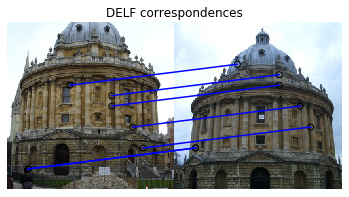

Found inliers for image 4177 -> 14


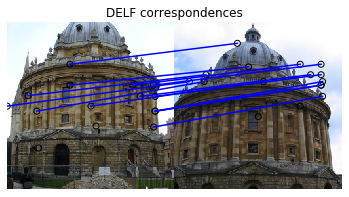

Found inliers for image 114 -> 2


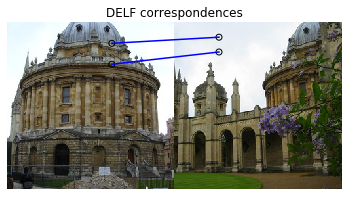

Found inliers for image 4210 -> 3


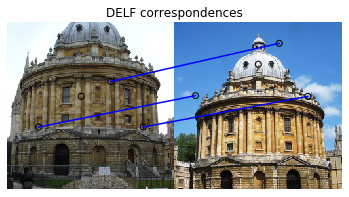

Found inliers for image 4211 -> 2


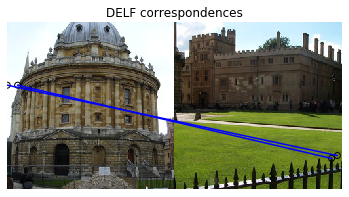

Found inliers for image 126 -> 3


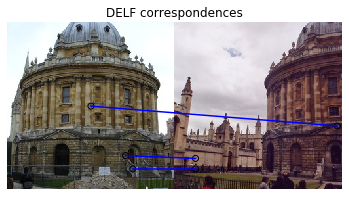

Found inliers for image 4223 -> 2


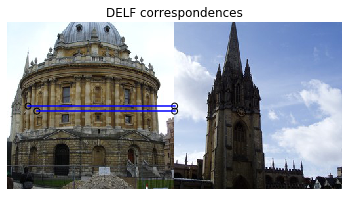

Found inliers for image 4242 -> 2


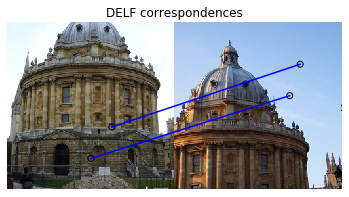

Found inliers for image 4321 -> 4


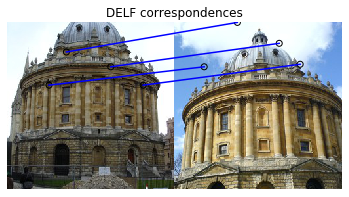

Found inliers for image 4338 -> 3


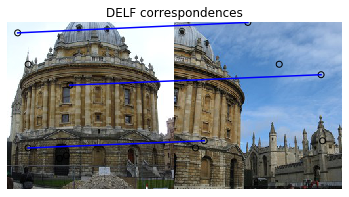

Found inliers for image 316 -> 1


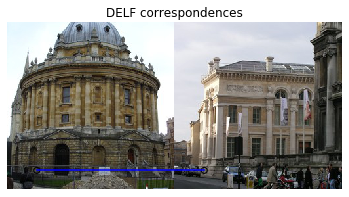

Found inliers for image 4497 -> 109


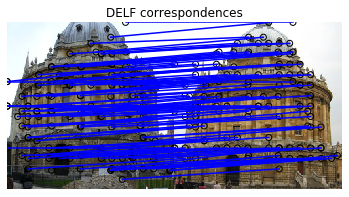

Found inliers for image 4499 -> 3


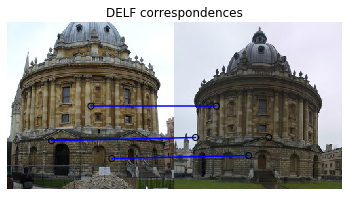

Found inliers for image 4502 -> 3


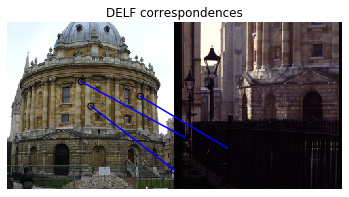

Found inliers for image 4506 -> 29


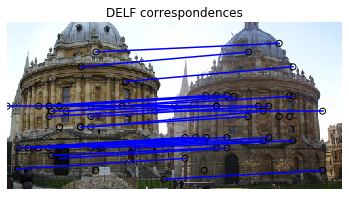

Found inliers for image 4507 -> 13


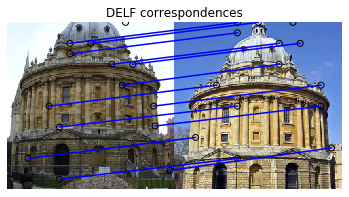

Found inliers for image 4514 -> 2


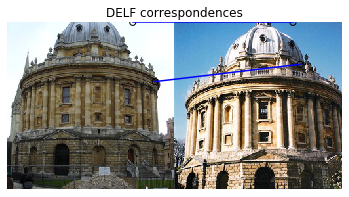

Found inliers for image 4515 -> 11


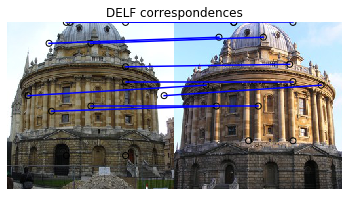

Found inliers for image 4518 -> 10


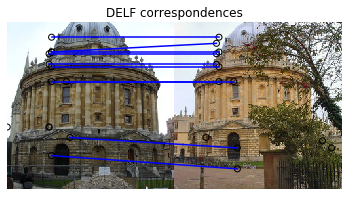

Found inliers for image 4520 -> 95


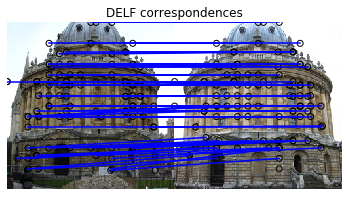

Found inliers for image 4521 -> 20


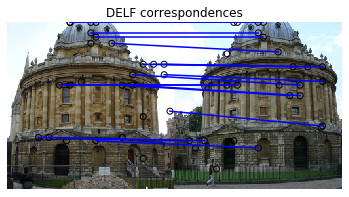

Found inliers for image 4524 -> 2


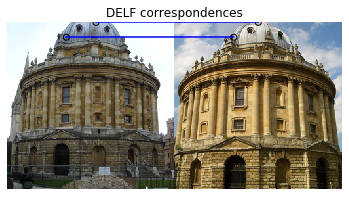

Found inliers for image 4525 -> 3


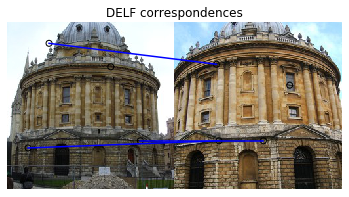

Found inliers for image 4529 -> 3


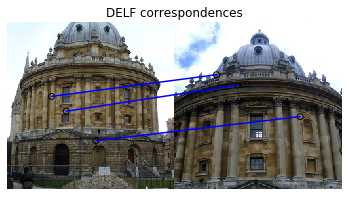

Found inliers for image 4530 -> 8


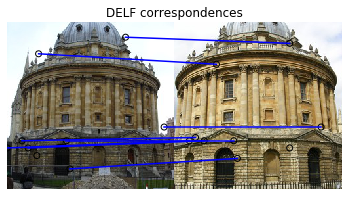

Found inliers for image 4532 -> 3


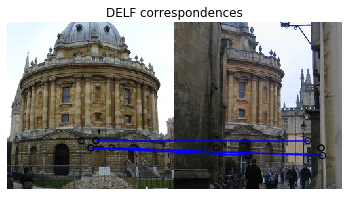

Found inliers for image 4535 -> 24


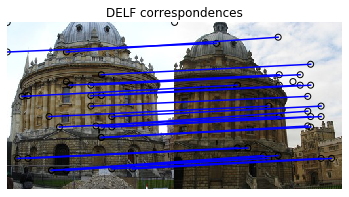

Found inliers for image 4536 -> 3


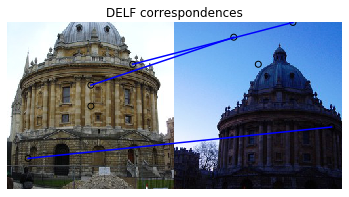

Found inliers for image 4537 -> 2


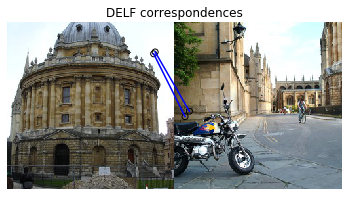

Found inliers for image 4538 -> 2


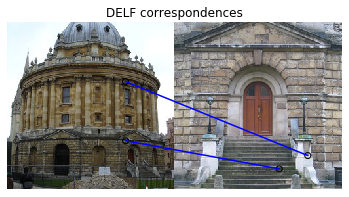

Found inliers for image 4539 -> 22


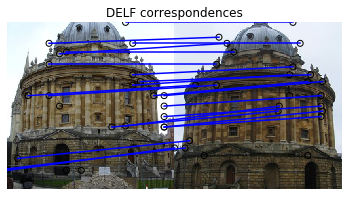

Found inliers for image 4540 -> 23


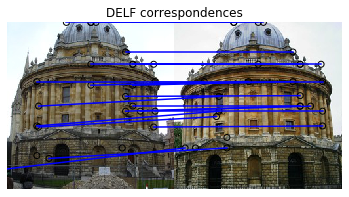

Found inliers for image 4545 -> 5


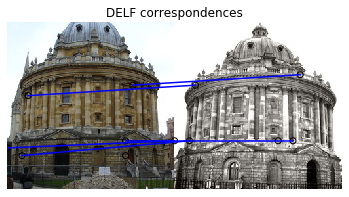

Found inliers for image 4548 -> 1


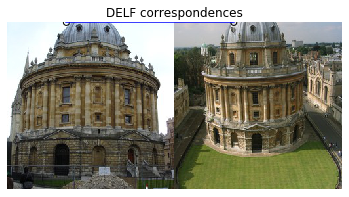

Found inliers for image 4550 -> 30


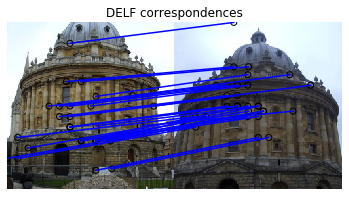

Found inliers for image 4551 -> 6


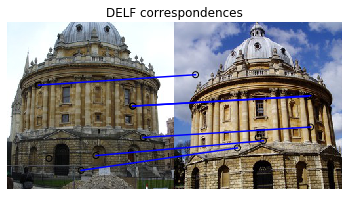

Found inliers for image 4555 -> 4


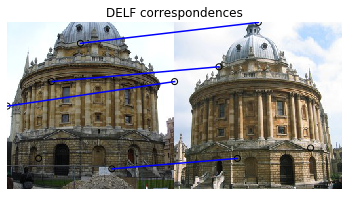

Found inliers for image 4556 -> 6


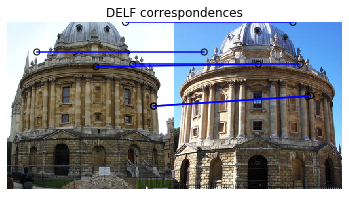

Found inliers for image 4561 -> 4


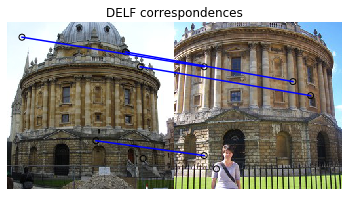

Found inliers for image 4562 -> 3


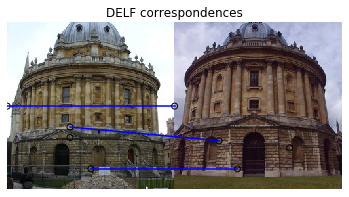

Found inliers for image 4565 -> 7


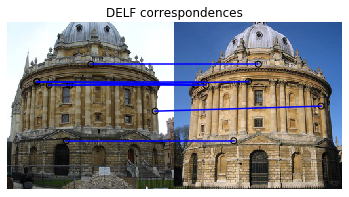

Found inliers for image 4566 -> 1


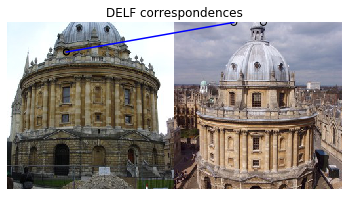

Found inliers for image 4567 -> 13


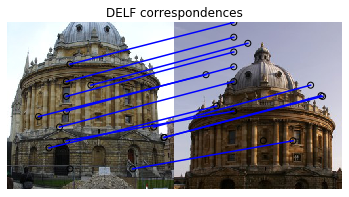

Found inliers for image 4570 -> 3


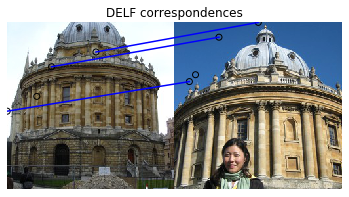

Found inliers for image 4571 -> 19


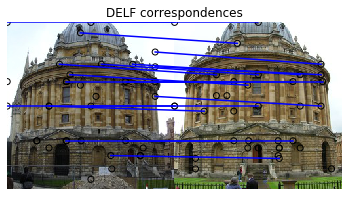

Found inliers for image 4572 -> 8


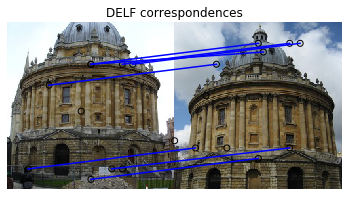

Found inliers for image 4573 -> 2


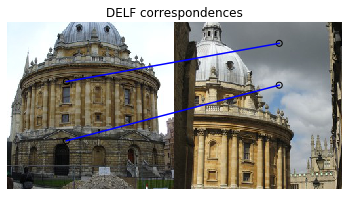

Found inliers for image 4574 -> 12


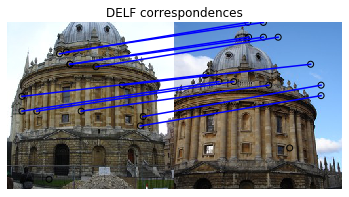

Found inliers for image 4576 -> 12


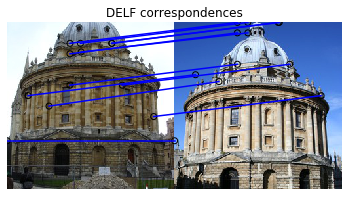

Found inliers for image 4577 -> 14


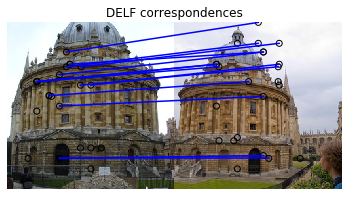

Found inliers for image 4578 -> 3


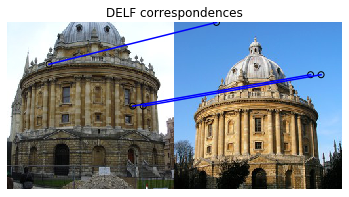

Found inliers for image 4579 -> 3


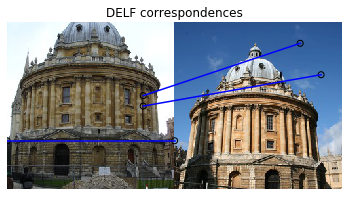

Found inliers for image 4583 -> 14


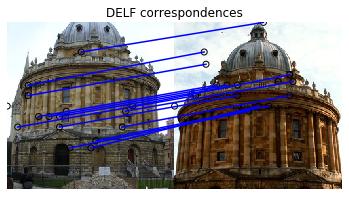

Found inliers for image 4585 -> 12


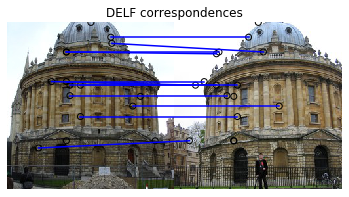

Found inliers for image 4586 -> 8


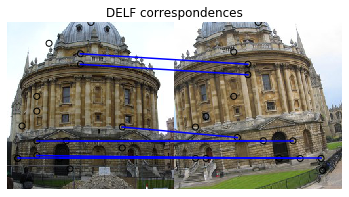

Found inliers for image 491 -> 2


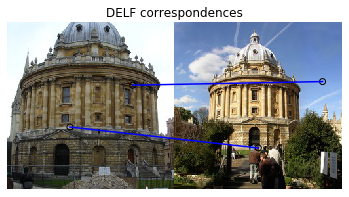

Found inliers for image 492 -> 5


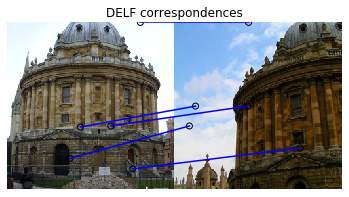

Found inliers for image 4587 -> 15


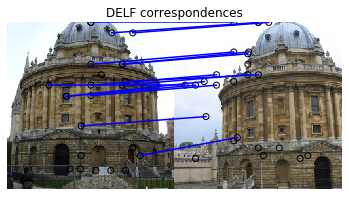

Found inliers for image 4593 -> 12


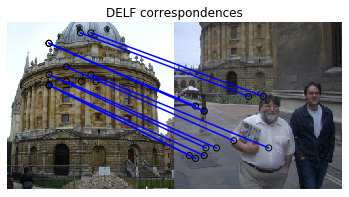

Found inliers for image 4596 -> 3


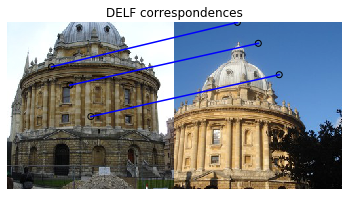

Found inliers for image 4598 -> 6


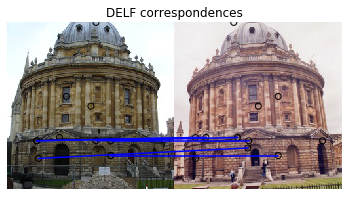

Found inliers for image 4604 -> 22


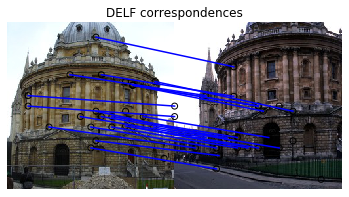

Found inliers for image 4606 -> 5


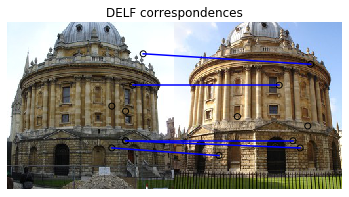

Found inliers for image 4607 -> 3


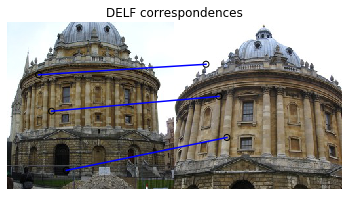

Found inliers for image 4608 -> 6


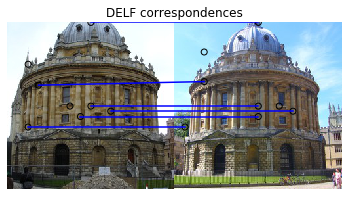

Found inliers for image 4609 -> 47


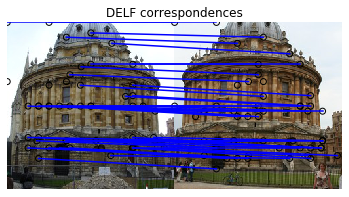

Found inliers for image 4610 -> 5


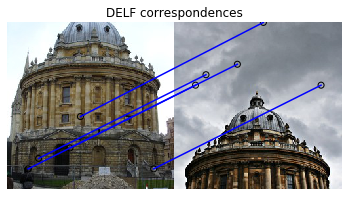

Found inliers for image 4612 -> 2


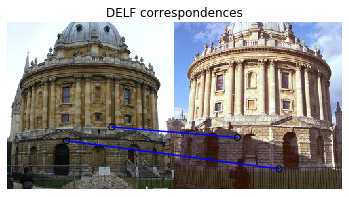

Found inliers for image 4613 -> 36


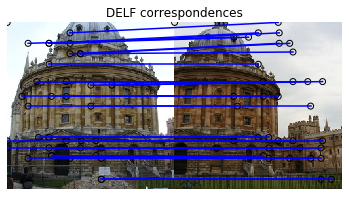

Found inliers for image 4614 -> 9


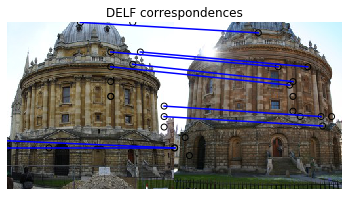

Found inliers for image 4615 -> 24


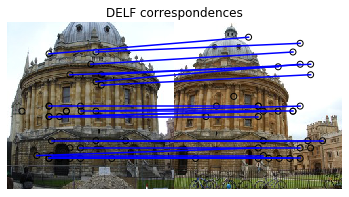

Found inliers for image 4616 -> 147


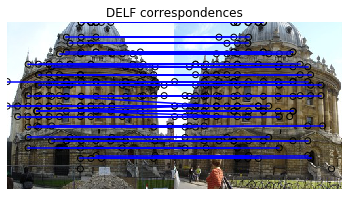

Found inliers for image 4617 -> 2


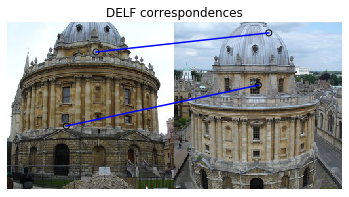

Found inliers for image 4621 -> 18


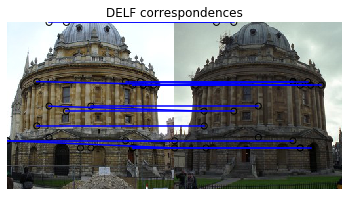

Found inliers for image 4623 -> 7


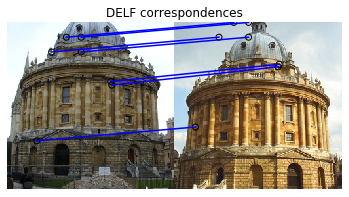

Found inliers for image 531 -> 2


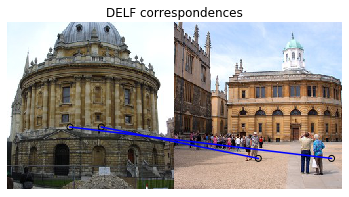

Found inliers for image 4624 -> 2


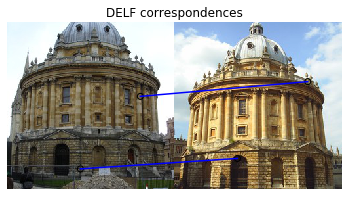

Found inliers for image 4628 -> 122


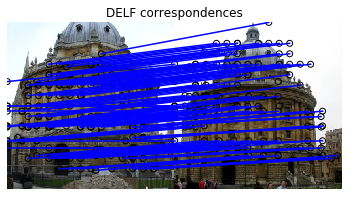

Found inliers for image 4629 -> 27


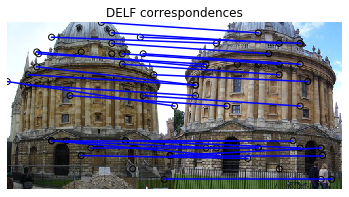

Found inliers for image 4631 -> 2


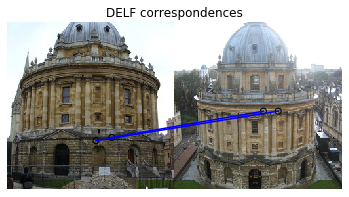

Found inliers for image 555 -> 6


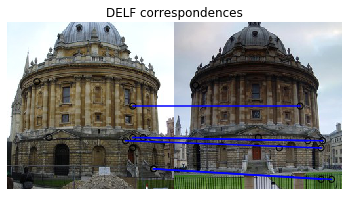

Found inliers for image 556 -> 5


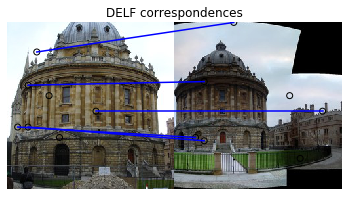

Found inliers for image 4666 -> 26


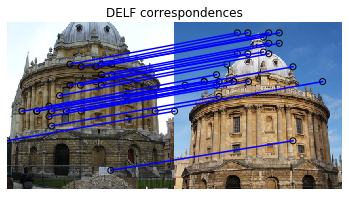

Found inliers for image 4667 -> 6


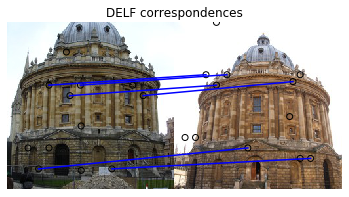

Found inliers for image 4668 -> 9


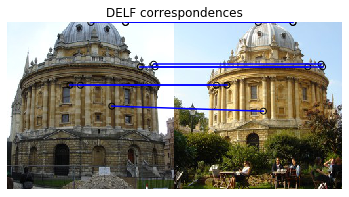

Found inliers for image 4672 -> 6


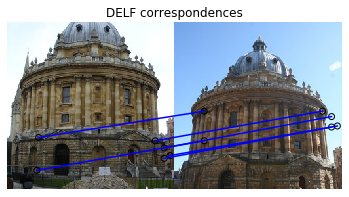

Found inliers for image 4673 -> 7


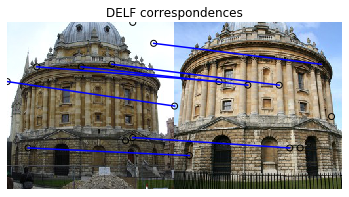

Found inliers for image 4674 -> 13


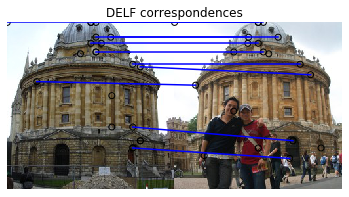

Found inliers for image 4675 -> 6


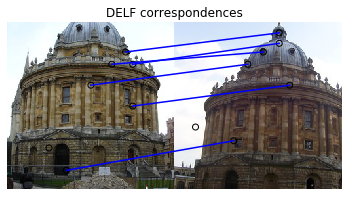

Found inliers for image 4676 -> 11


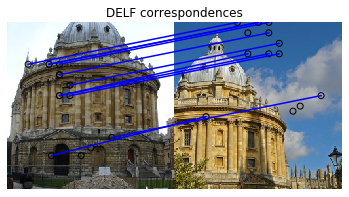

Found inliers for image 4677 -> 63


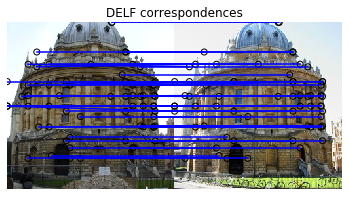

Found inliers for image 4678 -> 5


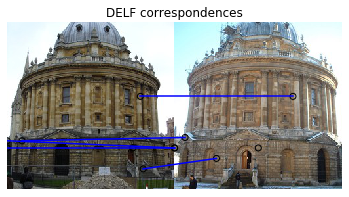

Found inliers for image 4680 -> 5


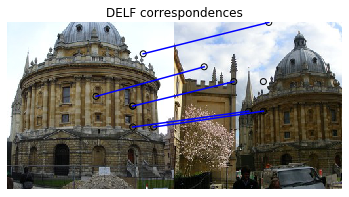

Found inliers for image 4685 -> 3


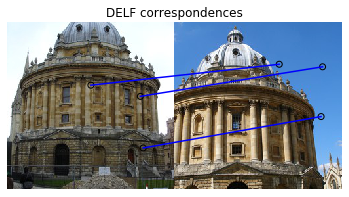

Found inliers for image 4686 -> 3


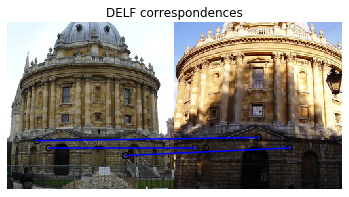

Found inliers for image 4689 -> 13


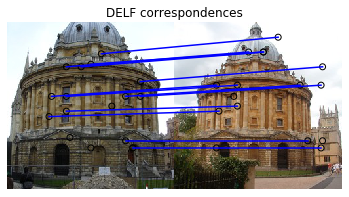

Found inliers for image 4690 -> 8


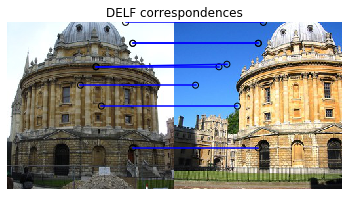

Found inliers for image 596 -> 2


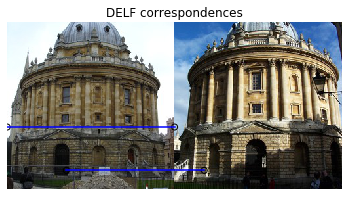

Found inliers for image 4692 -> 6


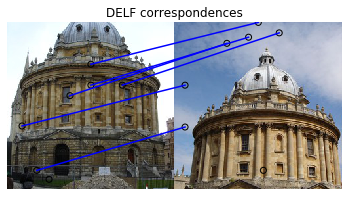

Found inliers for image 4693 -> 7


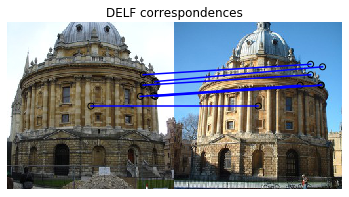

Found inliers for image 4697 -> 8


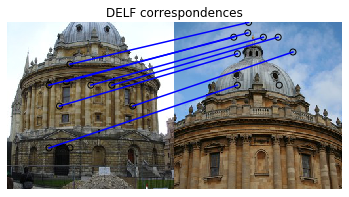

Found inliers for image 4699 -> 23


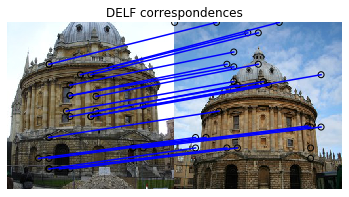

Found inliers for image 4702 -> 9


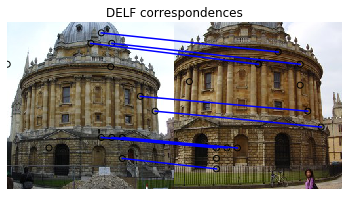

Found inliers for image 4703 -> 2


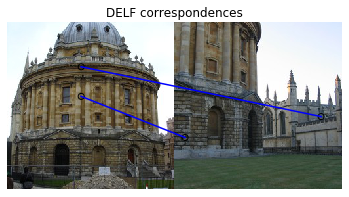

Found inliers for image 4705 -> 8


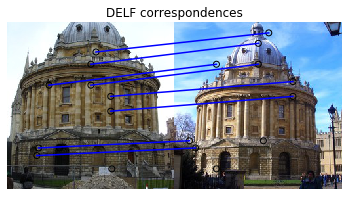

Found inliers for image 4706 -> 76


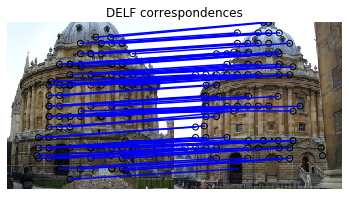

Found inliers for image 4708 -> 10


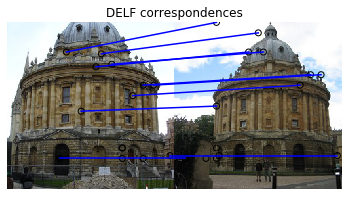

Found inliers for image 4711 -> 39


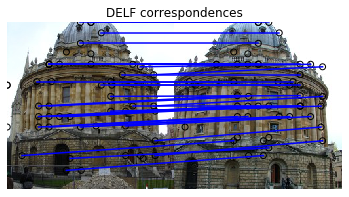

Found inliers for image 4712 -> 17


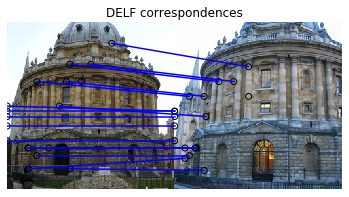

Found inliers for image 618 -> 6


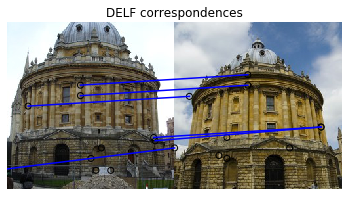

Found inliers for image 4714 -> 5


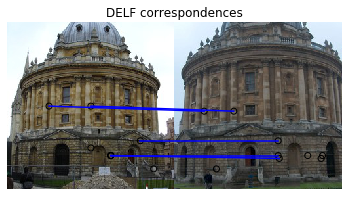

Found inliers for image 4716 -> 5


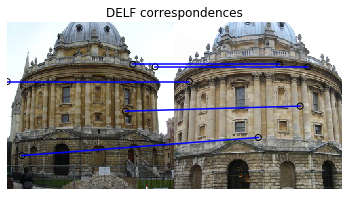

Found inliers for image 4720 -> 2


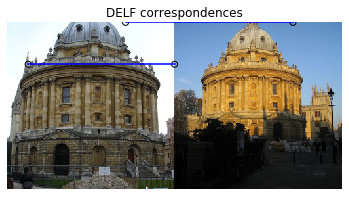

Found inliers for image 4723 -> 3


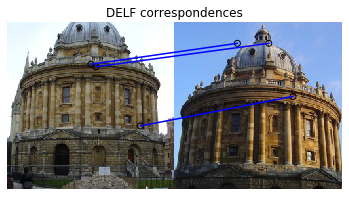

Found inliers for image 4726 -> 5


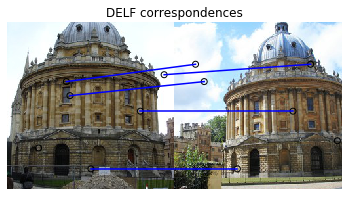

Found inliers for image 4727 -> 3


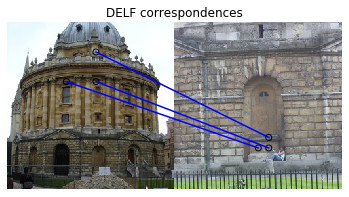

Found inliers for image 4728 -> 13


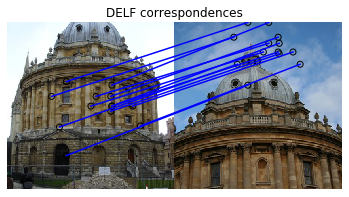

Found inliers for image 4734 -> 37


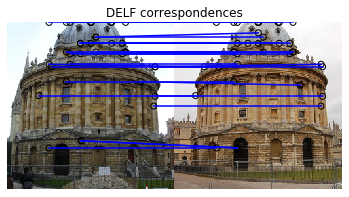

Found inliers for image 4735 -> 4


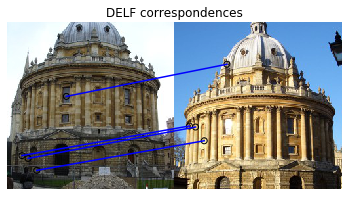

Found inliers for image 4737 -> 5


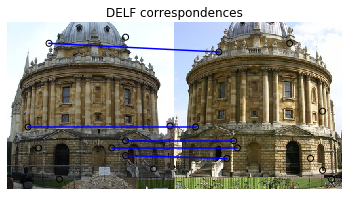

Found inliers for image 4741 -> 10


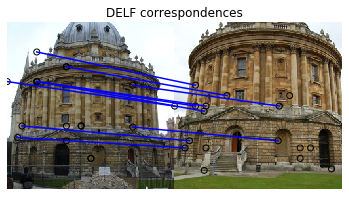

Found inliers for image 4742 -> 47


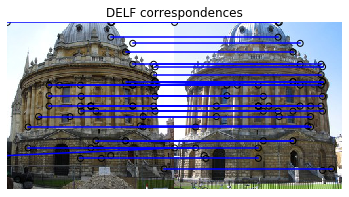

Found inliers for image 4743 -> 12


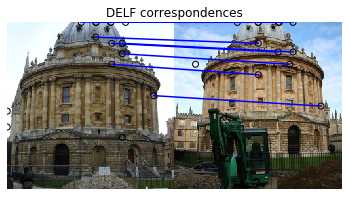

Found inliers for image 4744 -> 19


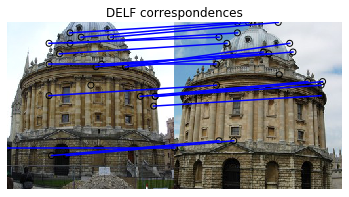

Found inliers for image 4745 -> 9


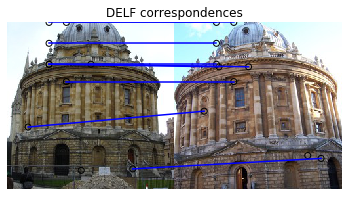

Found inliers for image 2699 -> 2


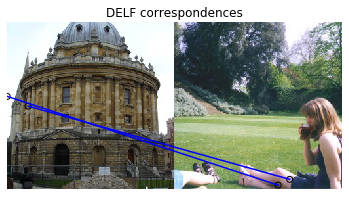

Found inliers for image 4748 -> 21


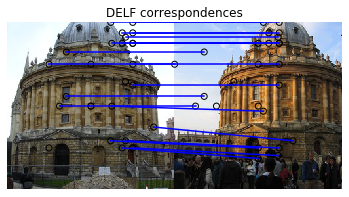

Found inliers for image 4750 -> 4


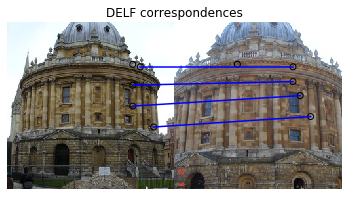

Found inliers for image 4751 -> 5


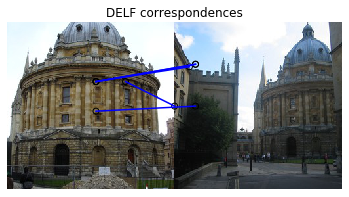

Found inliers for image 4757 -> 5


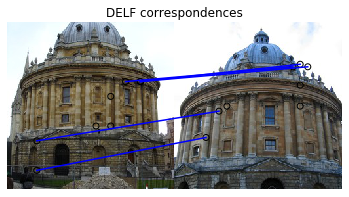

Found inliers for image 4758 -> 4


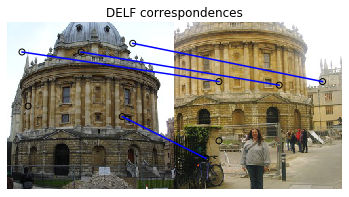

Found inliers for image 4759 -> 4


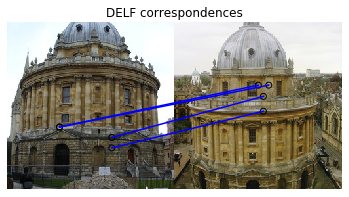

Found inliers for image 4762 -> 4


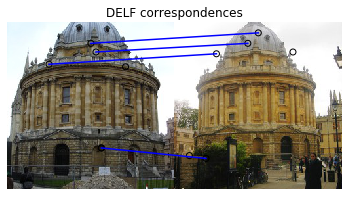

Found inliers for image 4766 -> 2


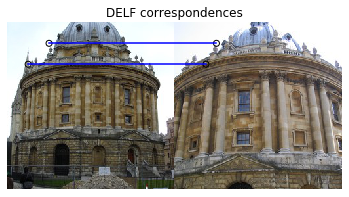

Found inliers for image 4769 -> 4


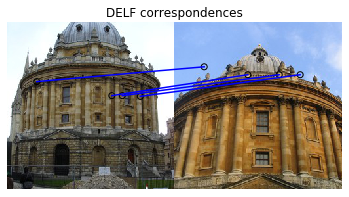

Found inliers for image 4774 -> 4


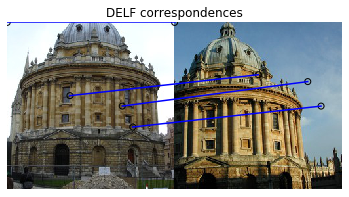

Found inliers for image 692 -> 4


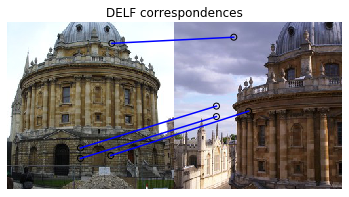

Found inliers for image 736 -> 3


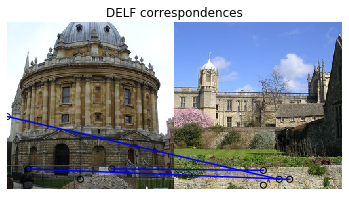

Found inliers for image 903 -> 2


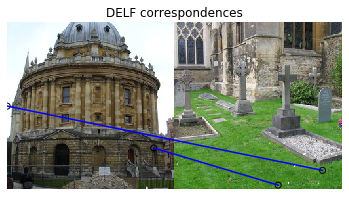

Found inliers for image 961 -> 2


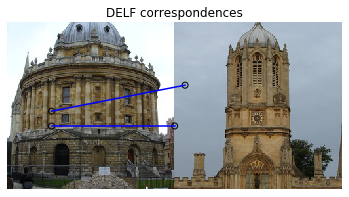

Found inliers for image 3120 -> 7


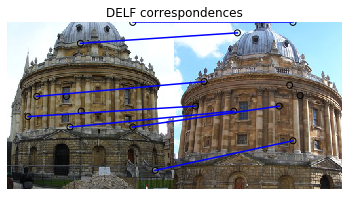

Found inliers for image 3189 -> 17


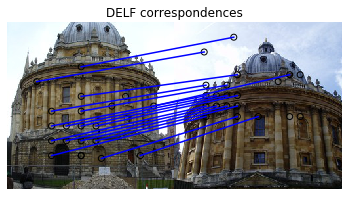

Found inliers for image 3208 -> 326


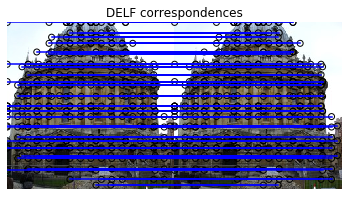

Found inliers for image 3247 -> 2


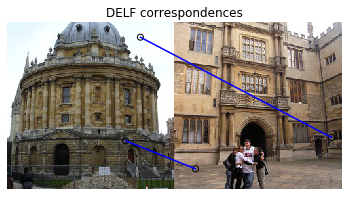

Found inliers for image 3290 -> 2


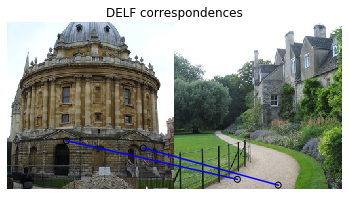

Found inliers for image 3319 -> 6


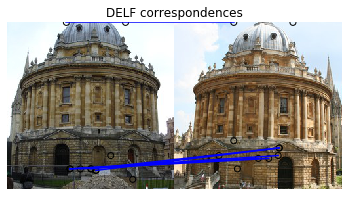

Found inliers for image 1302 -> 2


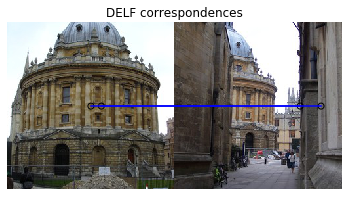

Found inliers for image 3350 -> 7


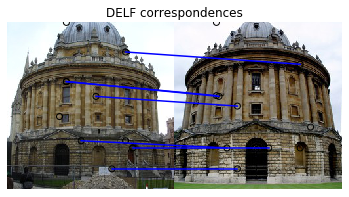

Found inliers for image 3416 -> 10


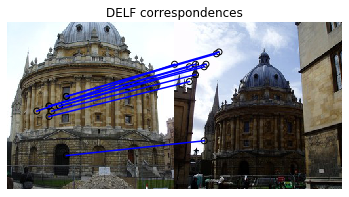

Found inliers for image 3434 -> 2


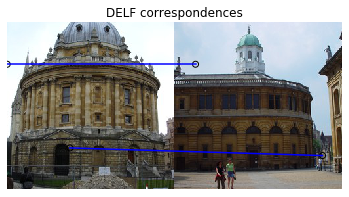

Found inliers for image 3549 -> 10


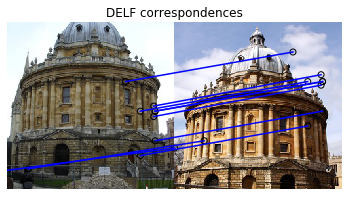

Found inliers for image 3563 -> 2


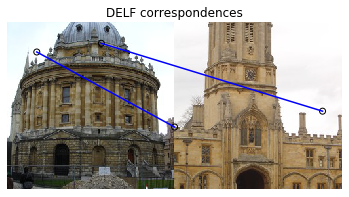

Found inliers for image 1583 -> 12


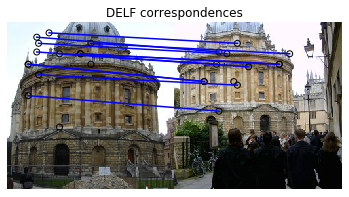

Found inliers for image 3654 -> 3


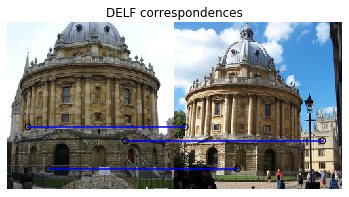

Found inliers for image 1618 -> 5


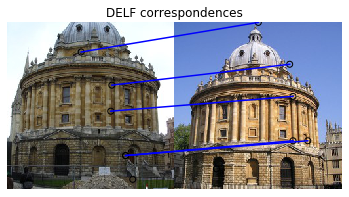

Found inliers for image 3667 -> 4


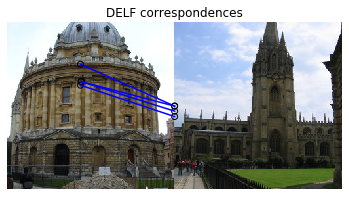

Found inliers for image 3714 -> 3


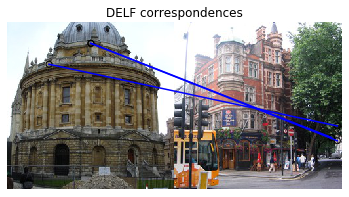

Found inliers for image 3730 -> 3


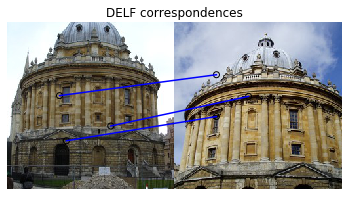

Found inliers for image 3800 -> 28


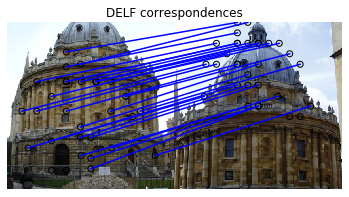

Found inliers for image 3865 -> 17


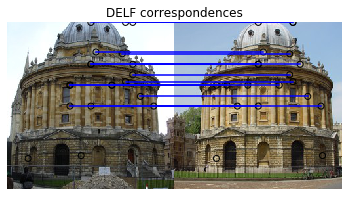

Found inliers for image 3872 -> 19


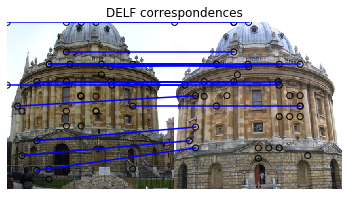

Found inliers for image 3895 -> 4


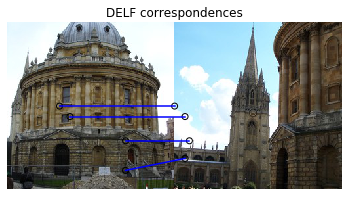

Found inliers for image 3911 -> 20


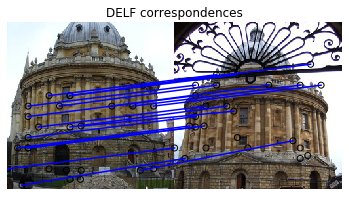

Found inliers for image 3957 -> 2


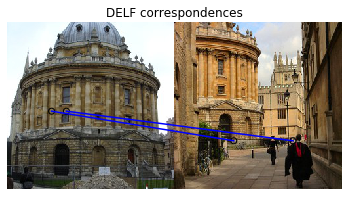

Found inliers for image 3987 -> 8


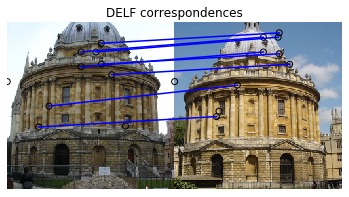

Found inliers for image 3988 -> 7


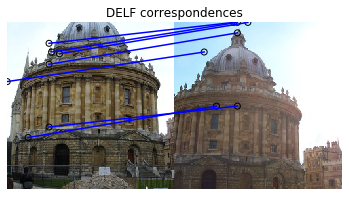

Found inliers for image 4057 -> 14


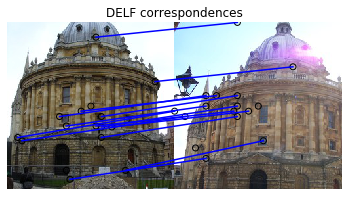

Found inliers for image 4066 -> 3


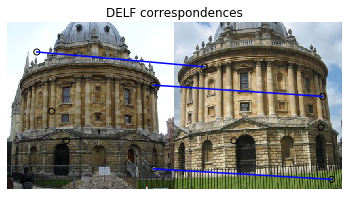

In [30]:
# Array to keep track of all candidates in database.
inliers_counts = []
# Read the resized query image for plotting.
img_1 = mpimg.imread(resized_image)
for index in unique_image_indexes:
    locations_2_use_query, locations_2_use_db = get_locations_2_use(index, indices, accumulated_indexes_boundaries)
    # Perform geometric verification using RANSAC.
    _, inliers = ransac(
        (locations_2_use_db, locations_2_use_query), # source and destination coordinates
        AffineTransform,
        min_samples=3,
        residual_threshold=20,
        max_trials=1000)
    # If no inlier is found for a database candidate image, we continue on to the next one.
    if inliers is None or len(inliers) == 0:
        continue
    # the number of inliers as the score for retrieved images.
    inliers_counts.append({"index": index, "inliers": sum(inliers)})
    print('Found inliers for image {} -> {}'.format(index, sum(inliers)))
    # Visualize correspondences.
    _, ax = plt.subplots()
    img_2 = mpimg.imread(db_images[index])
    inlier_idxs = np.nonzero(inliers)[0]
    plot_matches(
        ax,
        img_1,
        img_2,
        locations_2_use_db,
        locations_2_use_query,
        np.column_stack((inlier_idxs, inlier_idxs)),
        matches_color='b')
    ax.axis('off')
    ax.set_title('DELF correspondences')
    plt.show()

In [31]:
inliers_counts

[{'index': 4142, 'inliers': 7},
 {'index': 4177, 'inliers': 14},
 {'index': 114, 'inliers': 2},
 {'index': 4210, 'inliers': 3},
 {'index': 4211, 'inliers': 2},
 {'index': 126, 'inliers': 3},
 {'index': 4223, 'inliers': 2},
 {'index': 4242, 'inliers': 2},
 {'index': 4321, 'inliers': 4},
 {'index': 4338, 'inliers': 3},
 {'index': 316, 'inliers': 1},
 {'index': 4497, 'inliers': 109},
 {'index': 4499, 'inliers': 3},
 {'index': 4502, 'inliers': 3},
 {'index': 4506, 'inliers': 29},
 {'index': 4507, 'inliers': 13},
 {'index': 4514, 'inliers': 2},
 {'index': 4515, 'inliers': 11},
 {'index': 4518, 'inliers': 10},
 {'index': 4520, 'inliers': 95},
 {'index': 4521, 'inliers': 20},
 {'index': 4524, 'inliers': 2},
 {'index': 4525, 'inliers': 3},
 {'index': 4529, 'inliers': 3},
 {'index': 4530, 'inliers': 8},
 {'index': 4532, 'inliers': 3},
 {'index': 4535, 'inliers': 24},
 {'index': 4536, 'inliers': 3},
 {'index': 4537, 'inliers': 2},
 {'index': 4538, 'inliers': 2},
 {'index': 4539, 'inliers': 22},


### Show the top match result
Employ the number of inliers as the score for retrieved images.

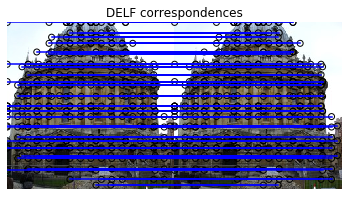

In [33]:
top_match = sorted(inliers_counts, key=lambda k: k['inliers'], reverse=True)[0]

index = top_match['index']
#print('Best guess for this image:', building_descs[index])
locations_2_use_query, locations_2_use_db = get_locations_2_use(index, indices, accumulated_indexes_boundaries)
# Perform geometric verification using RANSAC.
_, inliers = ransac(
    (locations_2_use_db, locations_2_use_query), # source and destination coordinates
    AffineTransform,
    min_samples=3,
    residual_threshold=20,
    max_trials=1000)
# Visualize correspondences.
_, ax = plt.subplots()
img_2 = mpimg.imread(db_images[index])
inlier_idxs = np.nonzero(inliers)[0]
plot_matches(
    ax,
    img_1,
    img_2,
    locations_2_use_db,
    locations_2_use_query,
    np.column_stack((inlier_idxs, inlier_idxs)),
    matches_color='b')
ax.axis('off')
ax.set_title('DELF correspondences')
plt.show()

In [ ]:
import pandas as pd
df = pd.DataFrame(np.unique(locations_agg, axis=0), columns=['x', 'y'])
df.head()

In [ ]:
fig, axe = plt.subplots(ncols=1, figsize = (6,6))
df.plot.scatter(x = 'x', y='y', fontsize=15, ax = axe)
axe.set_ylabel("y", size = 20)
axe.set_xlabel("x", size = 20)
plt.show()

In [ ]:
np.array(accumulated_indexes_boundaries)